<a href="https://colab.research.google.com/github/shadmanshakib09/OMDENA-AIR-QUALITY-PREDICTION-PROJECT/blob/main/EDA_on_Air_Quality_of_Mexico_dataset___1_(Md_Shadman_Shakib).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [25]:
#connect drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [6]:
%cd /content/drive/MyDrive/omdena air quality pred

/content/drive/MyDrive/omdena air quality pred


In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
df = pd.read_csv("daily_data.csv")

In [5]:
df

,Unnamed: 0,date,temperature_2m_(°C),relative_humidity_2m_(%),dew_point_2m_(°C),apparent_temperature_(°C),precipitation_(mm),pressure_msl_(hPa),surface_pressure_(hPa),cloud_cover_(%),...,shortwave_radiation_sum_(MJ/m²),CO_(μg/m³),NO_(μg/m³),NO2_(μg/m³),O3_(μg/m³),SO2_(μg/m³),PM2_5_(μg/m³),PM10_(μg/m³),NH3_(μg/m³),AirQualityIndex
0,0,2020-11-27,24.700000,17.000000,-2.700000,22.414286,0.000000,1012.871429,789.014286,22.285714,...,20.72,620.368571,2.360000,18.735714,147.137143,30.995714,24.364286,27.098571,0.977143,3.285714
1,1,2020-11-28,17.908333,38.416667,1.850000,15.662500,0.000000,1015.187500,786.287500,17.708333,...,20.46,1130.700833,9.001667,52.530833,75.065000,82.094583,31.439167,40.817083,5.117083,3.250000
2,2,2020-11-29,17.129167,45.083333,3.616667,15.125000,0.000000,1015.041667,785.645833,8.583333,...,20.11,1296.341667,11.237500,53.783333,75.073333,54.012917,60.616667,77.074583,6.645000,4.625000
3,3,2020-11-30,16.516667,63.625000,9.037500,14.775000,0.004167,1018.604167,788.025000,54.750000,...,12.86,510.832083,2.308750,23.270000,46.929167,35.981250,18.531667,21.801250,1.420417,2.333333
4,4,2020-12-01,12.591667,67.166667,5.620833,10.291667,0.025000,1019.470833,785.925000,67.875000,...,17.74,1108.030417,20.433750,44.519167,29.937500,42.295000,26.802083,38.265417,3.243750,3.166667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1435,1435,2024-11-01,16.358333,70.208333,10.258333,15.737500,0.037500,1016.695833,786.433333,51.250000,...,18.21,1003.167083,9.180833,50.612083,42.998333,45.428333,31.942917,39.928750,2.451250,3.083333
1436,1436,2024-11-02,16.254167,75.291667,11.329167,16.095833,0.020833,1016.791667,786.441667,63.541667,...,17.67,939.885417,9.252917,37.011250,59.275417,52.075000,31.127917,37.004167,1.192500,3.166667
1437,1437,2024-11-03,16.195833,71.750000,10.387500,15.862500,0.037500,1015.270833,785.187500,26.666667,...,19.51,1659.193333,4.436250,56.850417,98.717917,33.766667,80.902500,96.509583,3.088333,4.708333
1438,1438,2024-11-04,16.612500,69.750000,10.183333,16.233333,0.000000,1013.700000,784.262500,23.791667,...,21.08,1276.731250,4.959167,48.973333,93.891250,29.693750,51.183333,63.317083,2.625417,3.750000


In [6]:
df.head()

,Unnamed: 0,date,temperature_2m_(°C),relative_humidity_2m_(%),dew_point_2m_(°C),apparent_temperature_(°C),precipitation_(mm),pressure_msl_(hPa),surface_pressure_(hPa),cloud_cover_(%),...,shortwave_radiation_sum_(MJ/m²),CO_(μg/m³),NO_(μg/m³),NO2_(μg/m³),O3_(μg/m³),SO2_(μg/m³),PM2_5_(μg/m³),PM10_(μg/m³),NH3_(μg/m³),AirQualityIndex
0,0,2020-11-27,24.700000,17.000000,-2.700000,22.414286,0.000000,1012.871429,789.014286,22.285714,...,20.72,620.368571,2.360000,18.735714,147.137143,30.995714,24.364286,27.098571,0.977143,3.285714
1,1,2020-11-28,17.908333,38.416667,1.850000,15.662500,0.000000,1015.187500,786.287500,17.708333,...,20.46,1130.700833,9.001667,52.530833,75.065000,82.094583,31.439167,40.817083,5.117083,3.250000
2,2,2020-11-29,17.129167,45.083333,3.616667,15.125000,0.000000,1015.041667,785.645833,8.583333,...,20.11,1296.341667,11.237500,53.783333,75.073333,54.012917,60.616667,77.074583,6.645000,4.625000
3,3,2020-11-30,16.516667,63.625000,9.037500,14.775000,0.004167,1018.604167,788.025000,54.750000,...,12.86,510.832083,2.308750,23.270000,46.929167,35.981250,18.531667,21.801250,1.420417,2.333333
4,4,2020-12-01,12.591667,67.166667,5.620833,10.291667,0.025000,1019.470833,785.925000,67.875000,...,17.74,1108.030417,20.433750,44.519167,29.937500,42.295000,26.802083,38.265417,3.243750,3.166667


In [7]:
#canceliing column 0
df = df.drop("Unnamed: 0", axis=1)

In [8]:
df.head()

,date,temperature_2m_(°C),relative_humidity_2m_(%),dew_point_2m_(°C),apparent_temperature_(°C),precipitation_(mm),pressure_msl_(hPa),surface_pressure_(hPa),cloud_cover_(%),cloud_cover_low_(%),...,shortwave_radiation_sum_(MJ/m²),CO_(μg/m³),NO_(μg/m³),NO2_(μg/m³),O3_(μg/m³),SO2_(μg/m³),PM2_5_(μg/m³),PM10_(μg/m³),NH3_(μg/m³),AirQualityIndex
0,2020-11-27,24.700000,17.000000,-2.700000,22.414286,0.000000,1012.871429,789.014286,22.285714,0.000000,...,20.72,620.368571,2.360000,18.735714,147.137143,30.995714,24.364286,27.098571,0.977143,3.285714
1,2020-11-28,17.908333,38.416667,1.850000,15.662500,0.000000,1015.187500,786.287500,17.708333,0.000000,...,20.46,1130.700833,9.001667,52.530833,75.065000,82.094583,31.439167,40.817083,5.117083,3.250000
2,2020-11-29,17.129167,45.083333,3.616667,15.125000,0.000000,1015.041667,785.645833,8.583333,0.000000,...,20.11,1296.341667,11.237500,53.783333,75.073333,54.012917,60.616667,77.074583,6.645000,4.625000
3,2020-11-30,16.516667,63.625000,9.037500,14.775000,0.004167,1018.604167,788.025000,54.750000,30.583333,...,12.86,510.832083,2.308750,23.270000,46.929167,35.981250,18.531667,21.801250,1.420417,2.333333
4,2020-12-01,12.591667,67.166667,5.620833,10.291667,0.025000,1019.470833,785.925000,67.875000,4.333333,...,17.74,1108.030417,20.433750,44.519167,29.937500,42.295000,26.802083,38.265417,3.243750,3.166667


In [9]:
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1440 entries, 0 to 1439
Data columns (total 32 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   date                             1440 non-null   object 
 1   temperature_2m_(°C)              1437 non-null   float64
 2   relative_humidity_2m_(%)         1437 non-null   float64
 3   dew_point_2m_(°C)                1437 non-null   float64
 4   apparent_temperature_(°C)        1437 non-null   float64
 5   precipitation_(mm)               1437 non-null   float64
 6   pressure_msl_(hPa)               1437 non-null   float64
 7   surface_pressure_(hPa)           1437 non-null   float64
 8   cloud_cover_(%)                  1437 non-null   float64
 9   cloud_cover_low_(%)              1437 non-null   float64
 10  cloud_cover_mid_(%)              1437 non-null   float64
 11  cloud_cover_high_(%)             1437 non-null   float64
 12  wind_speed_10m_(km/h

In [10]:
df.describe()

,temperature_2m_(°C),relative_humidity_2m_(%),dew_point_2m_(°C),apparent_temperature_(°C),precipitation_(mm),pressure_msl_(hPa),surface_pressure_(hPa),cloud_cover_(%),cloud_cover_low_(%),cloud_cover_mid_(%),...,shortwave_radiation_sum_(MJ/m²),CO_(μg/m³),NO_(μg/m³),NO2_(μg/m³),O3_(μg/m³),SO2_(μg/m³),PM2_5_(μg/m³),PM10_(μg/m³),NH3_(μg/m³),AirQualityIndex
count,1437.000000,1437.000000,1437.000000,1437.000000,1437.000000,1437.000000,1437.000000,1437.000000,1437.000000,1437.000000,...,1437.000000,1437.000000,1437.000000,1437.000000,1437.000000,1437.000000,1437.000000,1437.000000,1437.000000,1437.000000
mean,17.169625,59.031816,7.130037,15.882062,0.128766,1016.640397,786.900419,53.123808,14.098586,21.001466,...,22.332554,1071.986495,15.434538,35.787022,62.750334,39.869986,33.931535,43.651394,3.638213,3.113197
std,2.552793,16.611993,4.874768,2.872567,0.249978,2.827039,1.671569,31.020096,17.010787,19.301883,...,4.055109,459.632708,12.772197,21.485802,26.134911,16.031543,20.495068,27.783587,2.784927,0.959863
min,9.183333,10.666667,-15.420833,6.825000,0.000000,1007.800000,779.570833,0.000000,0.000000,0.000000,...,6.260000,274.538333,0.010000,-387.864167,-320.957083,6.740000,2.124583,-330.371250,0.000000,1.000000
25%,15.654167,46.125000,3.579167,13.908333,0.000000,1014.787500,785.883333,25.833333,0.000000,6.833333,...,19.810000,712.077083,4.702917,26.183750,46.864167,28.513750,18.602917,24.028333,1.247917,2.458333
50%,16.891667,60.750000,7.454167,16.283333,0.008333,1016.730435,787.004167,54.458333,5.833333,16.875000,...,22.680000,1051.564167,12.697083,34.312500,63.529583,37.739167,31.478333,41.697500,2.672917,3.166667
75%,18.500000,73.750000,11.591667,17.729167,0.137500,1018.679167,788.066667,81.916667,25.875000,28.458333,...,25.480000,1353.362500,23.637500,44.309583,78.110417,48.329583,45.436250,59.986667,5.897083,3.833333
max,25.370833,85.500000,14.595833,23.387500,2.479167,1025.245833,791.183333,100.000000,82.416667,100.000000,...,31.150000,2705.335833,84.511667,99.647083,263.210000,121.137083,114.607500,144.202083,13.515833,5.000000


In [11]:
#converting date into index col
df = df.set_index("date")

In [12]:
df.head()

,temperature_2m_(°C),relative_humidity_2m_(%),dew_point_2m_(°C),apparent_temperature_(°C),precipitation_(mm),pressure_msl_(hPa),surface_pressure_(hPa),cloud_cover_(%),cloud_cover_low_(%),cloud_cover_mid_(%),...,shortwave_radiation_sum_(MJ/m²),CO_(μg/m³),NO_(μg/m³),NO2_(μg/m³),O3_(μg/m³),SO2_(μg/m³),PM2_5_(μg/m³),PM10_(μg/m³),NH3_(μg/m³),AirQualityIndex
date,,,,,,,,,,,,,,,,,,,,,
2020-11-27,24.700000,17.000000,-2.700000,22.414286,0.000000,1012.871429,789.014286,22.285714,0.000000,0.000000,...,20.72,620.368571,2.360000,18.735714,147.137143,30.995714,24.364286,27.098571,0.977143,3.285714
2020-11-28,17.908333,38.416667,1.850000,15.662500,0.000000,1015.187500,786.287500,17.708333,0.000000,1.708333,...,20.46,1130.700833,9.001667,52.530833,75.065000,82.094583,31.439167,40.817083,5.117083,3.250000
2020-11-29,17.129167,45.083333,3.616667,15.125000,0.000000,1015.041667,785.645833,8.583333,0.000000,2.500000,...,20.11,1296.341667,11.237500,53.783333,75.073333,54.012917,60.616667,77.074583,6.645000,4.625000
2020-11-30,16.516667,63.625000,9.037500,14.775000,0.004167,1018.604167,788.025000,54.750000,30.583333,44.333333,...,12.86,510.832083,2.308750,23.270000,46.929167,35.981250,18.531667,21.801250,1.420417,2.333333
2020-12-01,12.591667,67.166667,5.620833,10.291667,0.025000,1019.470833,785.925000,67.875000,4.333333,19.791667,...,17.74,1108.030417,20.433750,44.519167,29.937500,42.295000,26.802083,38.265417,3.243750,3.166667


In [13]:
df.shape

(1440, 31)

In [14]:
df.isnull().sum()

,0
temperature_2m_(°C),3
relative_humidity_2m_(%),3
dew_point_2m_(°C),3
apparent_temperature_(°C),3
precipitation_(mm),3
pressure_msl_(hPa),3
surface_pressure_(hPa),3
cloud_cover_(%),3
cloud_cover_low_(%),3
cloud_cover_mid_(%),3


In [15]:
#cancelling the null row
df = df.dropna()
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1437 entries, 2020-11-27 to 2024-11-05
Data columns (total 31 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   temperature_2m_(°C)              1437 non-null   float64
 1   relative_humidity_2m_(%)         1437 non-null   float64
 2   dew_point_2m_(°C)                1437 non-null   float64
 3   apparent_temperature_(°C)        1437 non-null   float64
 4   precipitation_(mm)               1437 non-null   float64
 5   pressure_msl_(hPa)               1437 non-null   float64
 6   surface_pressure_(hPa)           1437 non-null   float64
 7   cloud_cover_(%)                  1437 non-null   float64
 8   cloud_cover_low_(%)              1437 non-null   float64
 9   cloud_cover_mid_(%)              1437 non-null   float64
 10  cloud_cover_high_(%)             1437 non-null   float64
 11  wind_speed_10m_(km/h)            1437 non-null   float64
 12  wind_speed

In [16]:
df.isnull().sum()

,0
temperature_2m_(°C),0
relative_humidity_2m_(%),0
dew_point_2m_(°C),0
apparent_temperature_(°C),0
precipitation_(mm),0
pressure_msl_(hPa),0
surface_pressure_(hPa),0
cloud_cover_(%),0
cloud_cover_low_(%),0
cloud_cover_mid_(%),0


In [38]:
sns.pairplot(df)

## Separating this column
CO_(μg/m³)                       
NO_(μg/m³)                       
NO2_(μg/m³)                      
O3_(μg/m³)                       
SO2_(μg/m³)                     
PM2_5_(μg/m³)                   
PM10_(μg/m³)                    
NH3_(μg/m³)                      
AirQualityIndex                  

In [17]:
#separating last 9 col
data_2 = df.iloc[:,22:]
data_2


,CO_(μg/m³),NO_(μg/m³),NO2_(μg/m³),O3_(μg/m³),SO2_(μg/m³),PM2_5_(μg/m³),PM10_(μg/m³),NH3_(μg/m³),AirQualityIndex
date,,,,,,,,,
2020-11-27,620.368571,2.360000,18.735714,147.137143,30.995714,24.364286,27.098571,0.977143,3.285714
2020-11-28,1130.700833,9.001667,52.530833,75.065000,82.094583,31.439167,40.817083,5.117083,3.250000
2020-11-29,1296.341667,11.237500,53.783333,75.073333,54.012917,60.616667,77.074583,6.645000,4.625000
2020-11-30,510.832083,2.308750,23.270000,46.929167,35.981250,18.531667,21.801250,1.420417,2.333333
2020-12-01,1108.030417,20.433750,44.519167,29.937500,42.295000,26.802083,38.265417,3.243750,3.166667
...,...,...,...,...,...,...,...,...,...
2024-11-01,1003.167083,9.180833,50.612083,42.998333,45.428333,31.942917,39.928750,2.451250,3.083333
2024-11-02,939.885417,9.252917,37.011250,59.275417,52.075000,31.127917,37.004167,1.192500,3.166667
2024-11-03,1659.193333,4.436250,56.850417,98.717917,33.766667,80.902500,96.509583,3.088333,4.708333


In [18]:
data_2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1437 entries, 2020-11-27 to 2024-11-05
Data columns (total 9 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   CO_(μg/m³)       1437 non-null   float64
 1   NO_(μg/m³)       1437 non-null   float64
 2   NO2_(μg/m³)      1437 non-null   float64
 3   O3_(μg/m³)       1437 non-null   float64
 4   SO2_(μg/m³)      1437 non-null   float64
 5   PM2_5_(μg/m³)    1437 non-null   float64
 6   PM10_(μg/m³)     1437 non-null   float64
 7   NH3_(μg/m³)      1437 non-null   float64
 8   AirQualityIndex  1437 non-null   float64
dtypes: float64(9)
memory usage: 144.6+ KB


In [19]:
data_2.describe()

,CO_(μg/m³),NO_(μg/m³),NO2_(μg/m³),O3_(μg/m³),SO2_(μg/m³),PM2_5_(μg/m³),PM10_(μg/m³),NH3_(μg/m³),AirQualityIndex
count,1437.000000,1437.000000,1437.000000,1437.000000,1437.000000,1437.000000,1437.000000,1437.000000,1437.000000
mean,1071.986495,15.434538,35.787022,62.750334,39.869986,33.931535,43.651394,3.638213,3.113197
std,459.632708,12.772197,21.485802,26.134911,16.031543,20.495068,27.783587,2.784927,0.959863
min,274.538333,0.010000,-387.864167,-320.957083,6.740000,2.124583,-330.371250,0.000000,1.000000
25%,712.077083,4.702917,26.183750,46.864167,28.513750,18.602917,24.028333,1.247917,2.458333
50%,1051.564167,12.697083,34.312500,63.529583,37.739167,31.478333,41.697500,2.672917,3.166667
75%,1353.362500,23.637500,44.309583,78.110417,48.329583,45.436250,59.986667,5.897083,3.833333
max,2705.335833,84.511667,99.647083,263.210000,121.137083,114.607500,144.202083,13.515833,5.000000


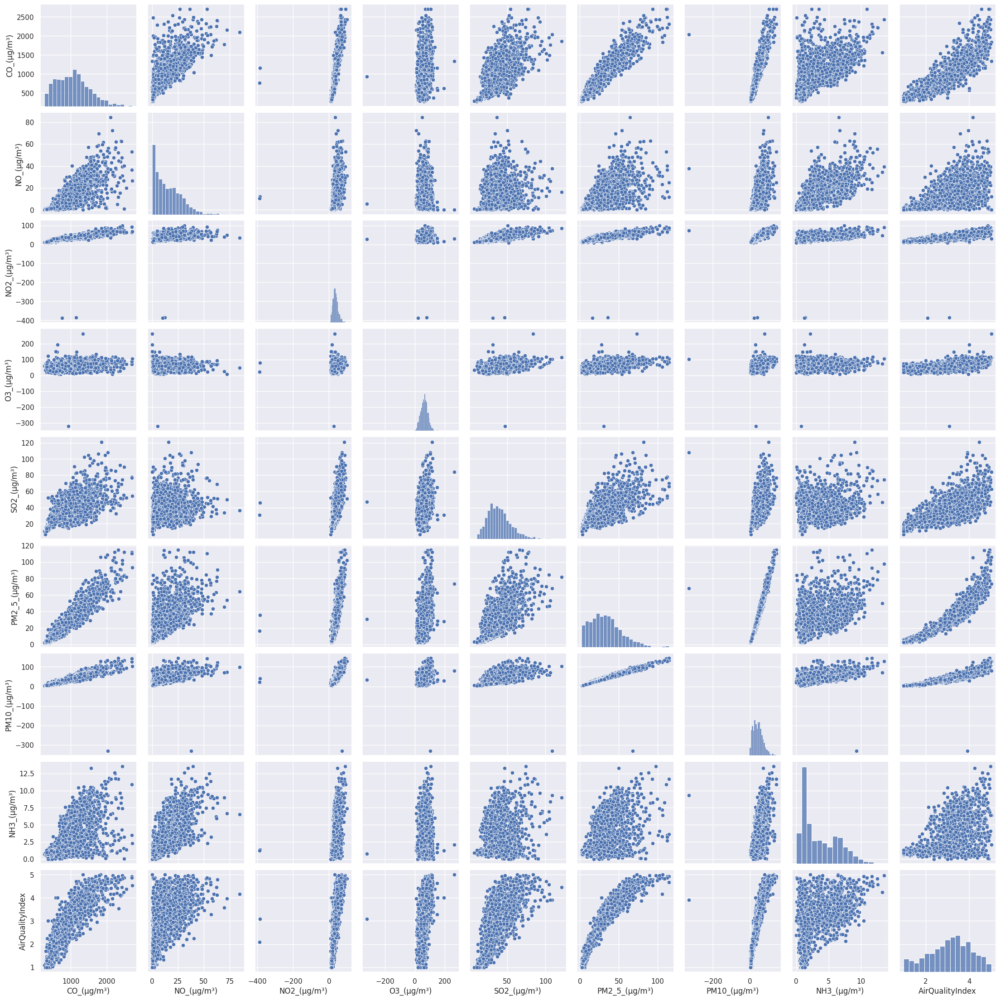

In [25]:
#pair plot
sns.pairplot(data_2)

**Based on these scatter plots, CO and PM2.5 appear to be the most useful features for predicting AQI, as they show clear, strong positive correlations with AQI values.**

<Axes: xlabel='CO_(μg/m³)'>

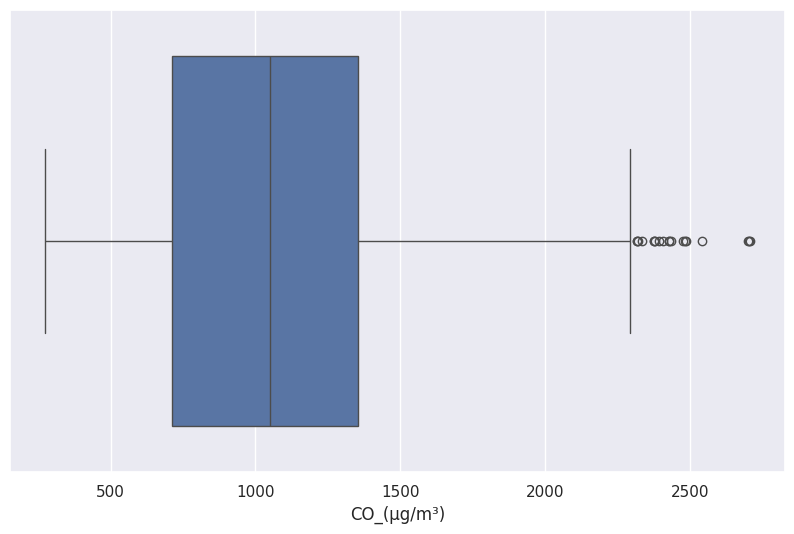

In [26]:
#box plot of CO_(μg/m³) and
plt.figure(figsize=(10,6))
sns.boxplot(x=df["CO_(μg/m³)"])

<Axes: xlabel='PM2_5_(μg/m³)'>

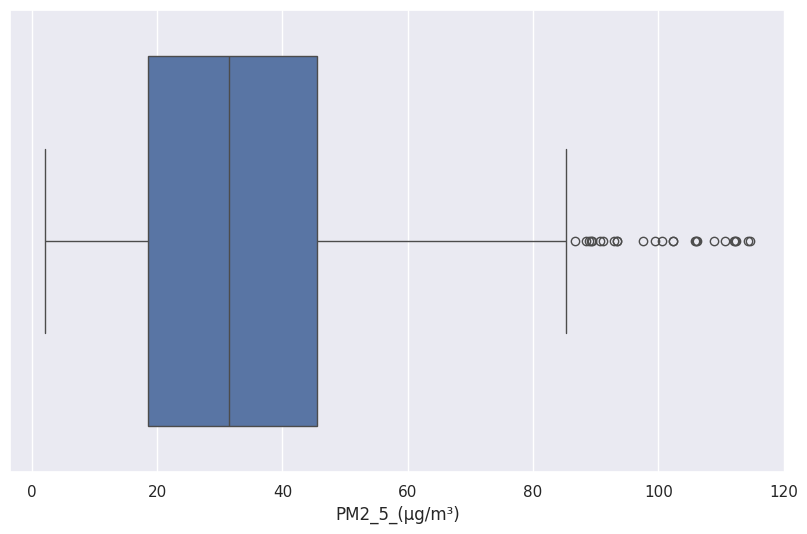

In [27]:
# box plot of PM2_5_(μg/m³)
plt.figure(figsize=(10,6))
sns.boxplot(x=df["PM2_5_(μg/m³)"])

<ipython-input-30-a5ced4edfc95>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df["PM2_5_(μg/m³)"])


<Axes: xlabel='PM2_5_(μg/m³)', ylabel='Density'>

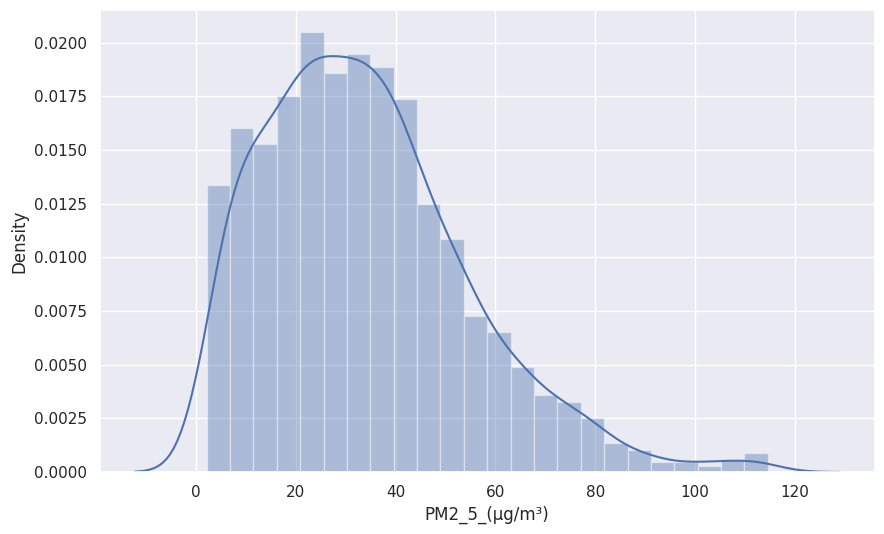

In [30]:
#dist plot
plt.figure(figsize=(10,6))
sns.distplot(df["PM2_5_(μg/m³)"])


<ipython-input-31-93aed2776a65>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df["CO_(μg/m³)"])


<Axes: xlabel='CO_(μg/m³)', ylabel='Density'>

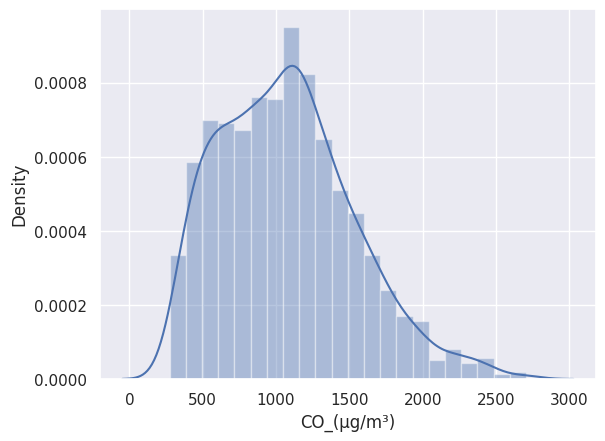

In [31]:
sns.distplot(df["CO_(μg/m³)"])

<Axes: >

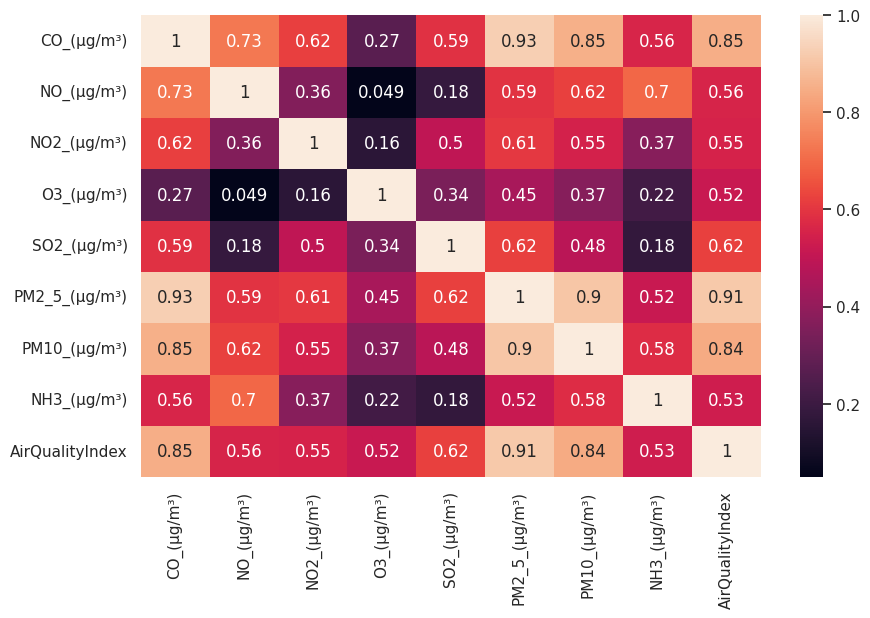

In [33]:
#heatmap
plt.figure(figsize=(10,6))
sns.heatmap(data_2.corr(), annot=True)

# EDA on Yearly data

In [8]:
data_yearly = pd.read_csv("yearly_data(Md.shadman shakib).csv")

In [9]:
data_yearly.head()

,Years,Average of CO_(μg/m³),Average of NO_(μg/m³),Average of NO2_(μg/m³),Average of O3_(μg/m³),Average of SO2_(μg/m³),Average of PM10_(μg/m³),Average of NH3_(μg/m³),Average of AirQualityIndex,Average of PM2_5_(μg/m³)
0,2020,1136.627662,19.167262,39.936925,62.110978,42.285532,52.249531,4.349490,3.568878,39.230765
1,2021,1063.240503,14.815599,35.763968,61.466751,41.738314,42.704631,3.348132,3.140421,33.513163
2,2022,1023.623636,15.072736,34.220693,65.741715,38.748178,42.471464,3.358308,3.132251,32.910634
3,2023,1109.448615,16.798254,37.599206,63.624422,41.030962,46.773136,3.715595,3.150213,36.070364
4,2024,1087.629565,14.564243,35.051894,59.804674,37.347847,41.511505,4.136354,2.963920,32.509874


In [10]:
#converting date into index col
data_yearly = data_yearly.set_index("Years")

In [11]:
data_yearly.head()

,Average of CO_(μg/m³),Average of NO_(μg/m³),Average of NO2_(μg/m³),Average of O3_(μg/m³),Average of SO2_(μg/m³),Average of PM10_(μg/m³),Average of NH3_(μg/m³),Average of AirQualityIndex,Average of PM2_5_(μg/m³)
Years,,,,,,,,,
2020,1136.627662,19.167262,39.936925,62.110978,42.285532,52.249531,4.349490,3.568878,39.230765
2021,1063.240503,14.815599,35.763968,61.466751,41.738314,42.704631,3.348132,3.140421,33.513163
2022,1023.623636,15.072736,34.220693,65.741715,38.748178,42.471464,3.358308,3.132251,32.910634
2023,1109.448615,16.798254,37.599206,63.624422,41.030962,46.773136,3.715595,3.150213,36.070364
2024,1087.629565,14.564243,35.051894,59.804674,37.347847,41.511505,4.136354,2.963920,32.509874


<Axes: xlabel='Years', ylabel='Average of CO_(μg/m³)'>

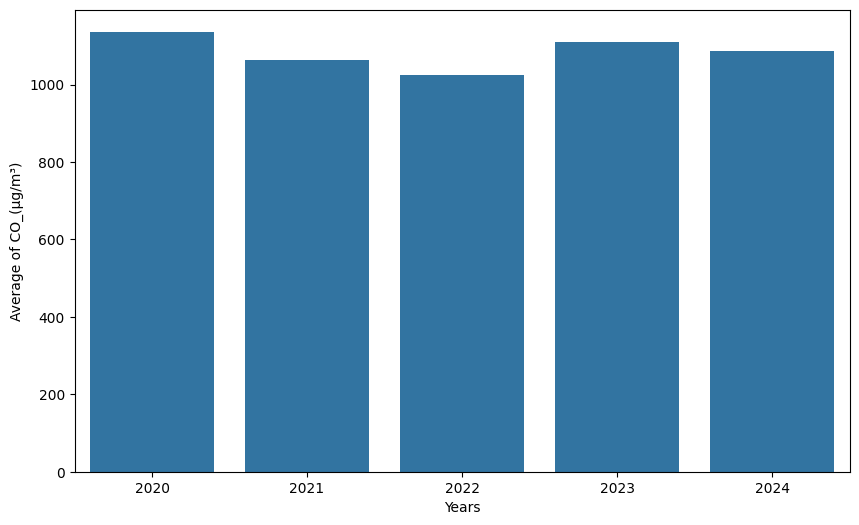

In [17]:
#yearly bar plot
plt.figure(figsize=(10,6))
sns.barplot(x=data_yearly.index, y=data_yearly["Average of CO_(μg/m³)"])


<Axes: xlabel='Years', ylabel='Average of PM2_5_(μg/m³)'>

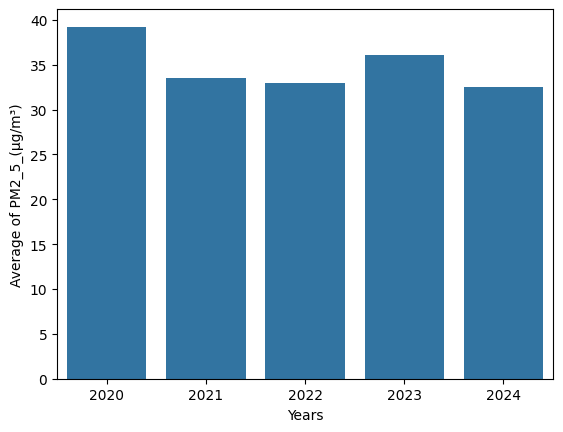

In [18]:
sns.barplot(x=data_yearly.index, y=data_yearly["Average of PM2_5_(μg/m³)"])

<Axes: xlabel='Years', ylabel='Average of CO_(μg/m³)'>

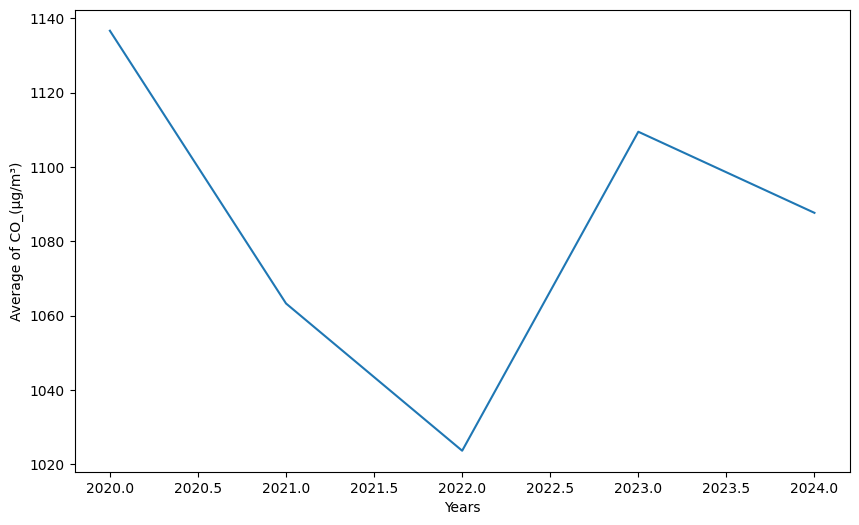

In [19]:
#line plot
plt.figure(figsize=(10,6))
sns.lineplot(x=data_yearly.index, y=data_yearly["Average of CO_(μg/m³)"])

<Axes: xlabel='Years', ylabel='Average of PM2_5_(μg/m³)'>

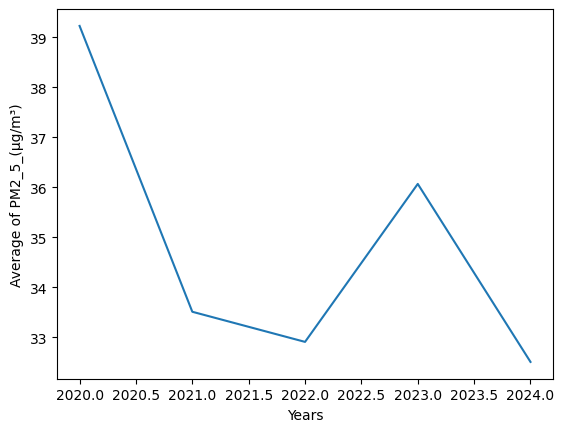

In [20]:
sns.lineplot(x=data_yearly.index, y=data_yearly["Average of PM2_5_(μg/m³)"])

<Axes: >

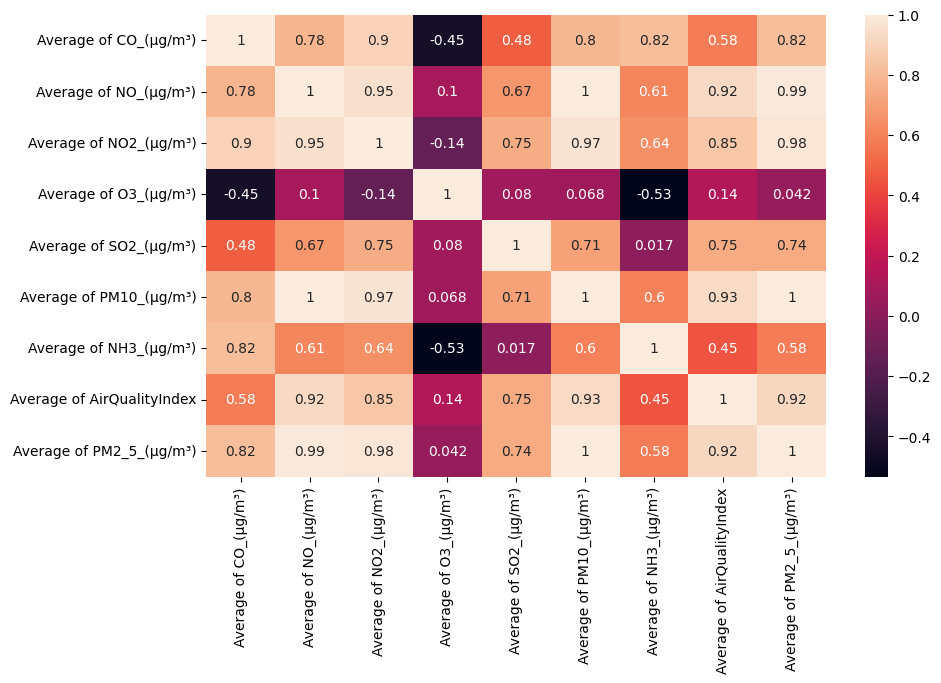

In [21]:
#heatmap
plt.figure(figsize=(10,6))
sns.heatmap(data_yearly.corr(), annot=True)